In [ ]:
! pip install --upgrade scipy

In [646]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

In [654]:
import matplotlib.pyplot as plt
        
def show_rgb(*img, figsize=(8, 3)):
    plt.figure(figsize=figsize)
    for i in img:
        plt.imshow(i, cmap='gray')
        plt.show()

def read(path):
    return cv2.imread(path, cv2.IMREAD_GRAYSCALE)


def read_rgb(path):
    x = cv2.imread(path, cv2.IMREAD_UNCHANGED)
    x = cv2.cvtColor(x, cv2.COLOR_BGR2RGB)
    return x

def neg(img):
    return 255 - img

def gray(img):
    return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

def resize(img, size=(100, 100)):
    return cv2.resize(img, size, interpolation=cv2.INTER_NEAREST)

def erode(img, it=1):
    kernel = np.ones((3, 3), np.uint8)
    return cv2.erode(img, kernel, iterations=it)

def dilate(img, it=1):
    kernel = np.ones((3, 3), np.uint8)
    return cv2.dilate(img, kernel, iterations=it)

def blur(x, it=1):
    for _ in range(it):
        x = cv2.GaussianBlur(x, (3, 3), cv2.BORDER_DEFAULT)
    return x

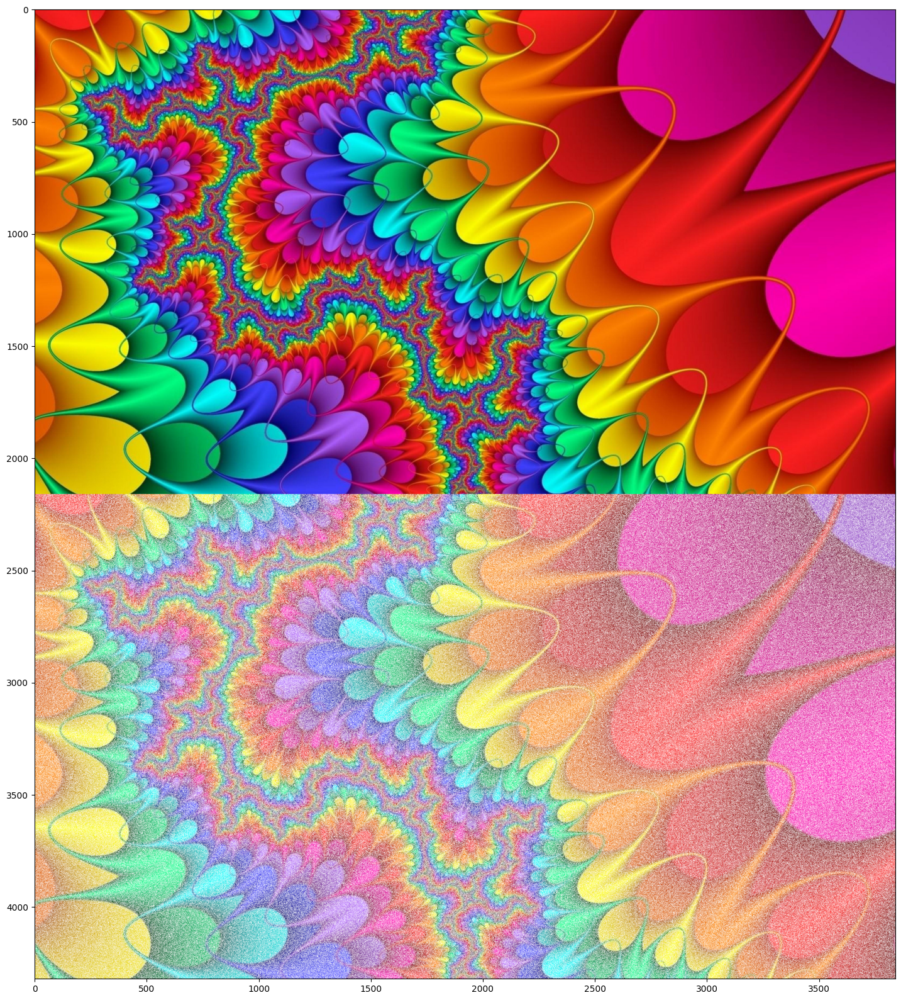

In [3]:
plt.figure(figsize=(20, 20))
### Read image
x = read_rgb('colorize.jpg')

### Introduce noise
noise = np.random.random(size=(x.shape[0], x.shape[1]))
# 10% noise
thresh = 0.5
mask = noise < thresh
y = x.copy()
y[mask, :] = (255, 255, 255)
show(np.vstack([x, y]))

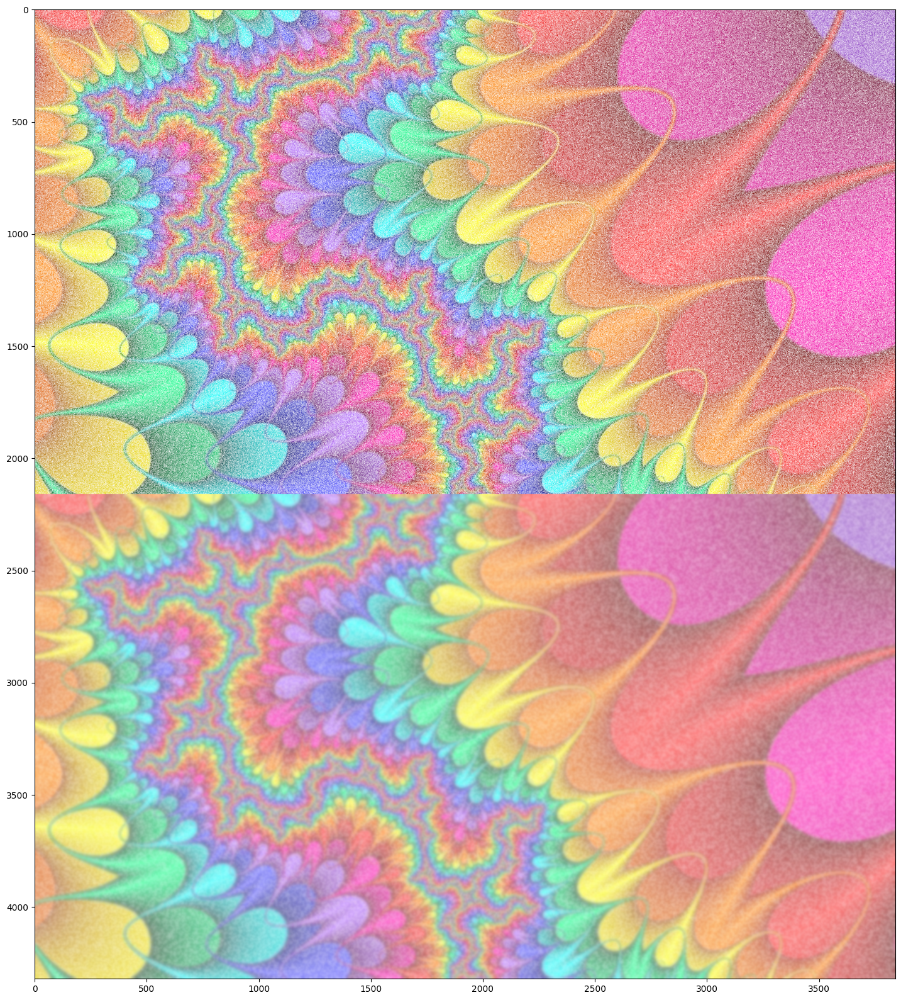

In [4]:
#### Fill noise with 
# z = cv2.fastNlMeansDenoisingColored(y,None,20,20,7,21) 
z = blur(y, it=100)
plt.figure(figsize=(20, 20))
show(np.vstack((y, z)))

##### Colorize with fuzzy logic

In [557]:
def f(i):
    return float("{:.2f}".format(i))

def prod(a, b):
    return a+b - a*b

def tri(x, color_intensity):
    scale = color_intensity/255
    if x <= 0.5:
        return scale * 2 * x
    else:
        return scale * 2 * (1-x)
    
def tri_min(x, color_intensity, minimum=0.1):
    peak = color_intensity/255
    add = abs(0.5-x)/0.5 * minimum
    return min(minimum + (peak - minimum) * (0.5 - np.abs(0.5-x)) * 2, peak)

class FuzzyColor:
    def __init__(self, rgb, fn=tri_min, conorm_fn=prod):
        # save original representation 
        r, g, b = rgb
        self._set_fn = fn
        self._conorm_fn = conorm_fn
        
        # initialize representation
        self._fuzzy_color = {}
        for i in np.arange(0.0, 1.01, 0.01):
            fi = f(i)
            self._fuzzy_color[fi] = 0.0
        
        # red 
        tmp = {}
        for i in np.arange(0.0, 1.01, 0.01):
            fi = f(i)
            x = fn(fi, r)
            tmp[fi] = x

        # first range
        red = tmp.copy()
        xs = np.array(list(red.keys()))
        ys = [red[x] for x in xs]
        xs*=0.66
        xs-=0.33
        xs = [f(x) for x in xs]
        red = dict(zip(xs, ys))

        for i in np.arange(0.0, 0.34, 0.01):
            fi = f(i)
            self._fuzzy_color[fi] = red[fi]
        
        # second range
        red = tmp.copy()
        xs = np.array(list(red.keys()))
        ys = [red[x] for x in xs]
        xs*=0.66
        xs+=0.66
        xs = [f(x) for x in xs]
        red = dict(zip(xs, ys))
        
        for i in np.arange(0.67, 1.01, 0.01):
            fi = f(i)
            self._fuzzy_color[fi] = red[fi]
        
        # green
        tmp = {}
        for i in np.arange(0.0, 1.01, 0.01):
            fi = f(i)
            x = fn(fi, g)
            tmp[fi] = x
        
        green = tmp.copy()
        xs = np.array(list(green.keys()))
        ys = [green[x] for x in xs]
        xs*=0.666
        xs = [f(x) for x in xs]
        green = dict(zip(xs, ys))
        
        for i in np.arange(0.0, 0.68, 0.01):
            fi = f(i)
            self._fuzzy_color[fi] = max(self._fuzzy_color.get(fi) or 0, green[fi])
            
        # blue 
        # XXX Quantization error in blue channel
        # FIXME use fidelity of 1000 to fix
        tmp = {}
        for i in np.arange(0.0, 1.01, 0.01):
            fi = f(i)
            x = fn(fi, b)
            tmp[fi] = x
            
        blue = tmp.copy()
        
        xs = np.array(list(blue.keys()))
        ys = [blue[x] for x in xs]
    
        xs*=0.67
        xs+=0.33
        xs = [f(x) for x in xs]
        blue = dict(zip(xs, ys))
        for i in np.arange(0.33, 1.01, 0.01):
            fi = f(i)
            self._fuzzy_color[fi] = max(self._fuzzy_color.get(fi) or 0, blue[fi])
            
    def plot(self):
        show(self)
        
    def power(self, n):
        xs = self._fuzzy_color.keys()
        ys = [self._fuzzy_color[c]**n for c in xs]
        _map = dict(zip(xs, ys))
        r, g, b = FuzzyColor.to_rgb(_map)
        return FuzzyColor((r, g, b), self._set_fn, self._conorm_fn)
            
    
    def __repr__(self):
        r, g, b = self.get_rgb()
        return str({
            'r': r,
            'g': g,
            'b': b
        })
    
    def get_rgb(self):
        r, g, b = FuzzyColor.to_rgb(self._fuzzy_color)
        return r, g, b
    
    def to_rgb(_map):
        r, g, b = _map[0.00], _map[0.33], _map[0.66]
        r = round(r*255)
        g = round(g*255)
        b = round(b*255)
        return r, g, b

    def __add__(self, other):
        assert self._set_fn == other._set_fn
        assert self._conorm_fn == other._conorm_fn
        
        # SM(x,y)=max(x,y) (maximum or Gödel t-conorm)
        # SP(x,y)=x+y−x⋅y (prod t-conorm, probabilistic sum)
        # SL(x,y)=min(x+y,1) (Lukasiewicz t-conorm, bounded sum)) 
        
        k = self._fuzzy_color.keys()
        _map = {}
        for i in k:
            av = self._fuzzy_color[i]
            bv = other._fuzzy_color[i]
            cv = self._conorm_fn(av, bv)
            _map[i] = cv

        r, g, b = _map[0.00], _map[0.33], _map[0.66]
        r = round(r*255)
        g = round(g*255)
        b = round(b*255)
        return FuzzyColor((r, g, b), self._set_fn, self._conorm_fn)
        
        
def show(*fc, figsize=(8, 3)):
    plt.figure(figsize=figsize)
    for f in fc:
        xs = f._fuzzy_color.keys()
        ys = [f._fuzzy_color[x] for x in xs]
        plt.plot(xs, ys)
    plt.legend(range(len(fc)))
    plt.xlim((0, 1))
    plt.ylim((0, 1))

In [484]:
FuzzyColor((0, 0, 255))

{'r': 0, 'g': 26, 'b': 250}

In [485]:
FuzzyColor((255, 0, 0))

{'r': 255, 'g': 26, 'b': 0}

In [486]:
FuzzyColor((0, 255, 0))

{'r': 26, 'g': 255, 'b': 30}

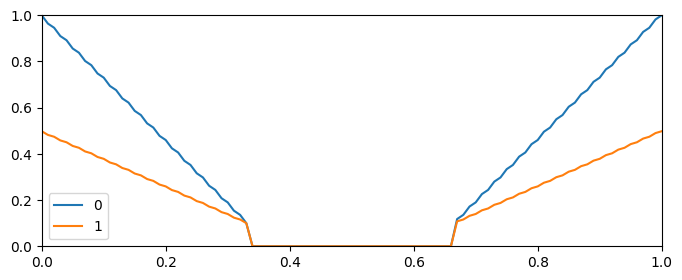

In [389]:
r1 = FuzzyColor((255, 0, 0))
r2 = FuzzyColor((127, 0, 0))
show(r1, r2)

In [487]:
red_and_blue = FuzzyColor((255, 0, 255), tri)
red_and_blue

{'r': 255, 'g': 0, 'b': 250}

{'r': 255, 'g': 26, 'b': 250}

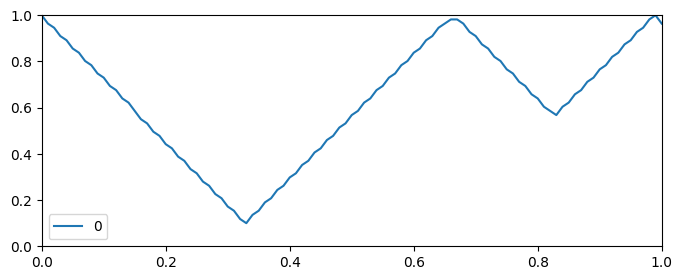

In [488]:
red_and_blue = FuzzyColor((255, 0, 255), tri_min)
red_and_blue.plot()
red_and_blue

({'r': 200, 'g': 26, 'b': 0},
 {'r': 26, 'g': 200, 'b': 29},
 {'r': 206, 'g': 206, 'b': 29})

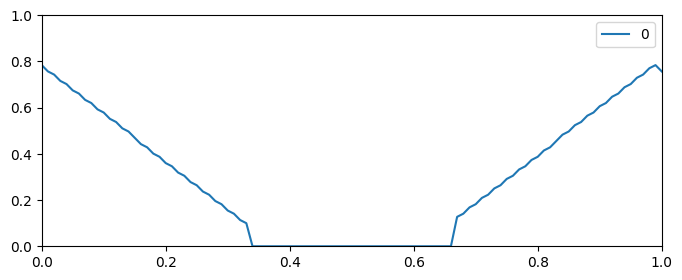

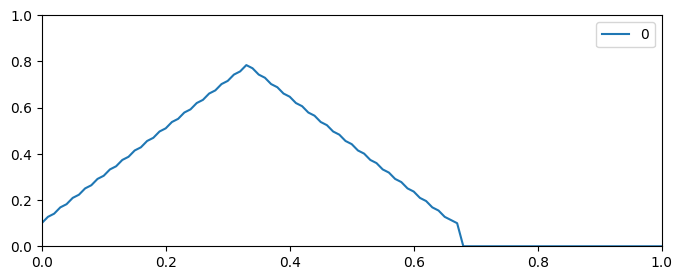

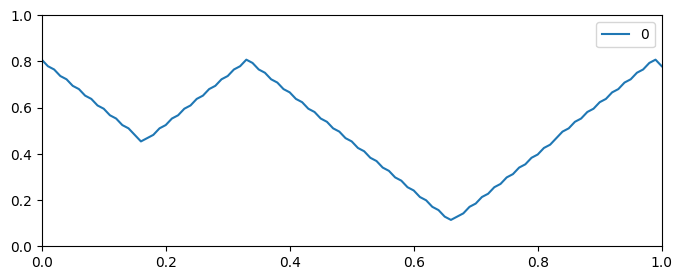

In [489]:
red = FuzzyColor((200, 0, 0), tri_min)
green = FuzzyColor((0, 200, 0), tri_min)
red_green = red + green
red.plot()
green.plot()
red_green.plot()
(red, green, red_green)

In [554]:
# Test red
n = 0
red = FuzzyColor((255, 0, 0))
xs = red._fuzzy_color.keys()
ys = [red._fuzzy_color[c]**n for c in xs]
_map = dict(zip(xs, ys))
r, g, b = FuzzyColor.to_rgb(_map)
red, (r, g, b)
# return FuzzyColor((r, g, b), self._set_fn, self._conorm_fn)

({'r': 255, 'g': 26, 'b': 0}, (255, 255, 255))

### Test

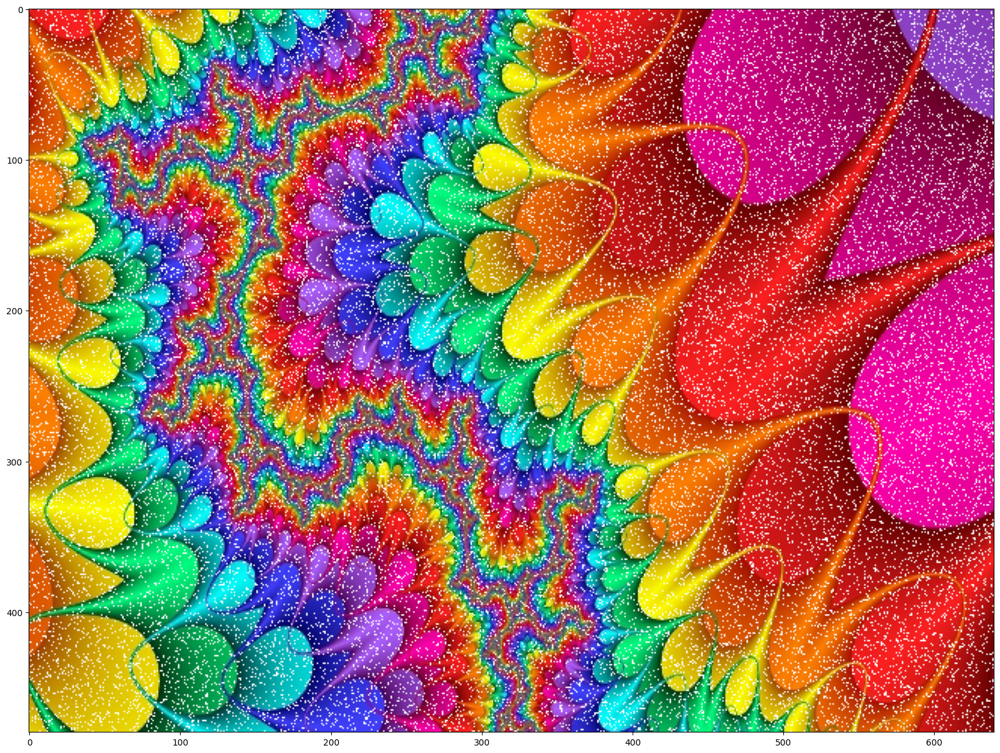

In [564]:
plt.figure(figsize=(20, 20))
### Read image
x = read_rgb('colorize.jpg')
x = resize(x, size=(640, 480))


### Introduce noise
noise = np.random.random(size=(x.shape[0], x.shape[1]))
# 10% noise
thresh = 0.1
mask = noise < thresh
y = x.copy()
y[mask, :] = (255, 255, 255)
# show(np.vstack([x, y]))

test = y
show_rgb(test)

  7%|████████████▍                                                                                                                                                                  | 34/480 [00:00<00:01, 335.35it/s]/var/folders/4x/vb5tl80s45v2f_k7_zb004bc0000gn/T/ipykernel_12802/2035325139.py:30: RuntimeWarning: Mean of empty slice.
  r_avg = neighbours_tensor[:, 0].mean()
/var/folders/4x/vb5tl80s45v2f_k7_zb004bc0000gn/T/ipykernel_12802/2035325139.py:31: RuntimeWarning: Mean of empty slice.
  g_avg = neighbours_tensor[:, 1].mean()
/var/folders/4x/vb5tl80s45v2f_k7_zb004bc0000gn/T/ipykernel_12802/2035325139.py:32: RuntimeWarning: Mean of empty slice.
  b_avg = neighbours_tensor[:, 2].mean()
100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 480/480 [00:01<00:00, 392.26it/s]


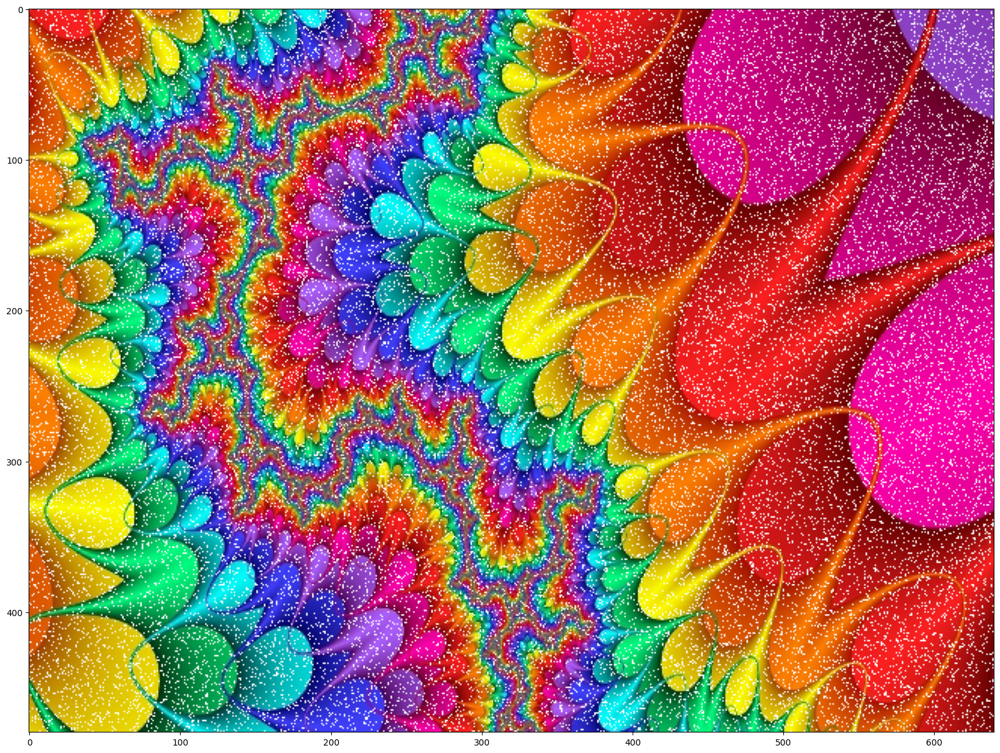

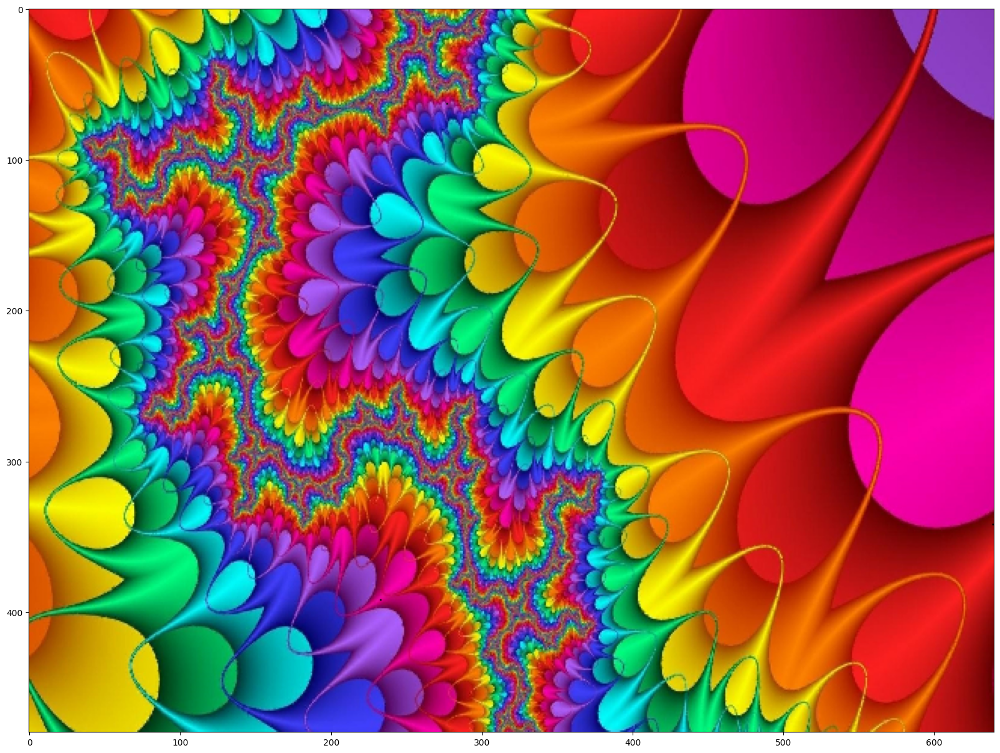

In [571]:
# Baseline algo
output = test.copy()
for y in tqdm(range(test.shape[0])):
    for x in range(test.shape[1]):
        r, g, b = test[y][x]
        if (r, g, b) == (255, 255, 255):
            # Add 4-neighbours non white pixels
            neighbours = []
            if 0 <= y+1 < test.shape[0]:
                n = test[y+1][x]
                if np.all(n != (255, 255, 255)):
                    neighbours.append(n)
                    
            if 0 <= y-1 < test.shape[0]:
                n = test[y-1][x]
                if np.all(n != (255, 255, 255)):
                    neighbours.append(n)
                    
            if 0 <= x+1 < test.shape[1]:
                n = test[y][x+1]
                if np.all(n != (255, 255, 255)):
                    neighbours.append(n)
                    
            if 0 <= x-1 < test.shape[1]:
                n = test[y][x-1]
                if np.all(n != (255, 255, 255)):
                    neighbours.append(n)
            
            neighbours_tensor = np.array(neighbours).reshape(-1, 3)
            r_avg = neighbours_tensor[:, 0].mean()
            g_avg = neighbours_tensor[:, 1].mean()
            b_avg = neighbours_tensor[:, 2].mean()
            output[y][x] = (r_avg, g_avg, b_avg)

plt.figure(figsize=(20, 20))
show_rgb(test)
plt.figure(figsize=(20, 20))
show_rgb(output)

In [573]:
# fuzzy-algo
output = test.copy()
for y in tqdm(range(test.shape[0])):
    for x in range(test.shape[1]):
        r, g, b = test[y][x]
        if (r, g, b) == (255, 255, 255):
            # Add 4-neighbours non white pixels
            neighbours = []
            if 0 <= y+1 < test.shape[0]:
                n = test[y+1][x]
                if np.all(n != (255, 255, 255)):
                    neighbours.append(n)
                    
            if 0 <= y-1 < test.shape[0]:
                n = test[y-1][x]
                if np.all(n != (255, 255, 255)):
                    neighbours.append(n)
                    
            if 0 <= x+1 < test.shape[1]:
                n = test[y][x+1]
                if np.all(n != (255, 255, 255)):
                    neighbours.append(n)
                    
            if 0 <= x-1 < test.shape[1]:
                n = test[y][x-1]
                if np.all(n != (255, 255, 255)):
                    neighbours.append(n)
            
            neighbours_fuzzy = [FuzzyColor(n) for n in neighbours]
            if len(neighbours_fuzzy) > 0:
                result = neighbours_fuzzy[0]
                for i in range(1, len(neighbours_fuzzy)):
                    result += neighbours_fuzzy[i]

                averaged = result.power(len(neighbours_fuzzy))
                r_avg, g_avg, b_avg = averaged.get_rgb()
                output[y][x] = (r_avg, g_avg, b_avg)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 480/480 [03:20<00:00,  2.39it/s]


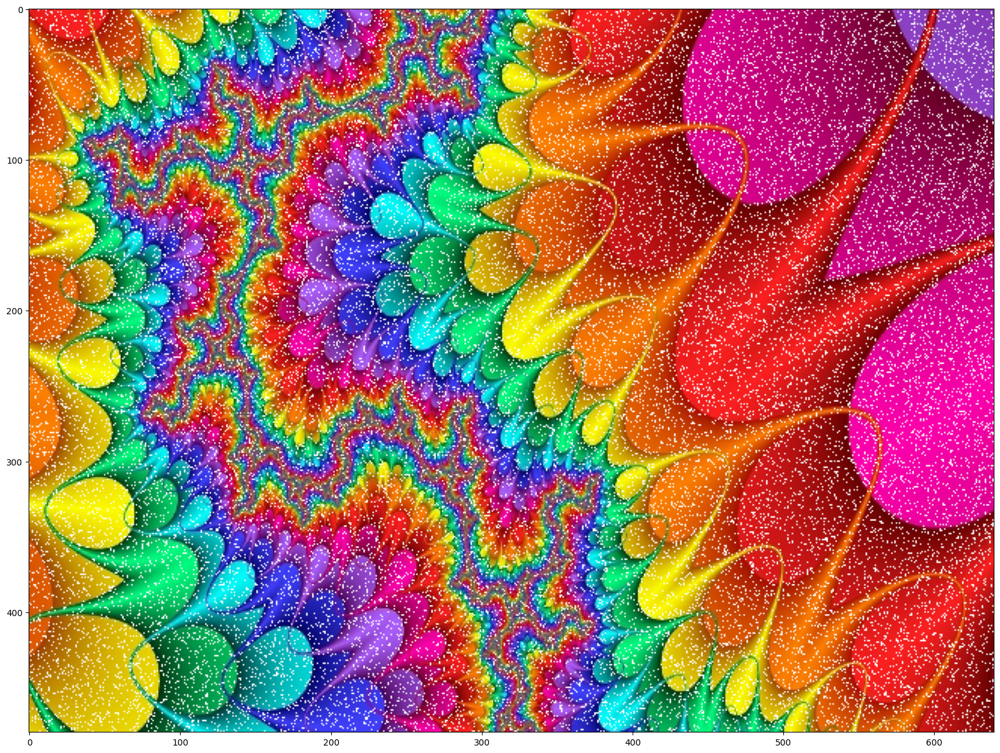

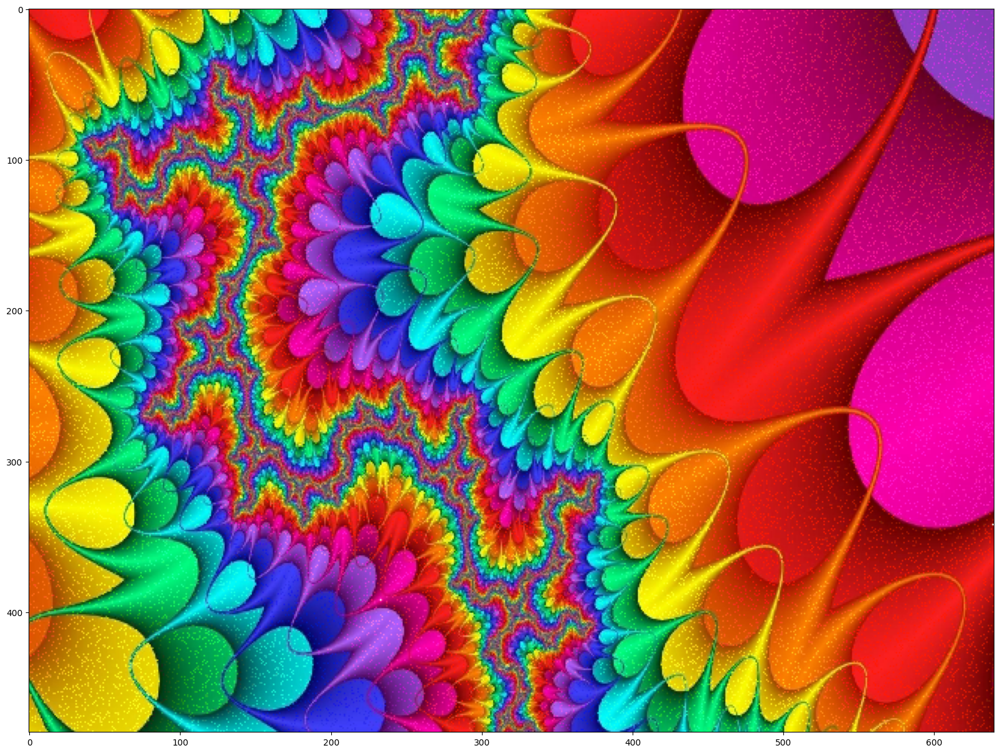

In [575]:
plt.figure(figsize=(20, 20))
show_rgb(test)
plt.figure(figsize=(20, 20))
show_rgb(output)

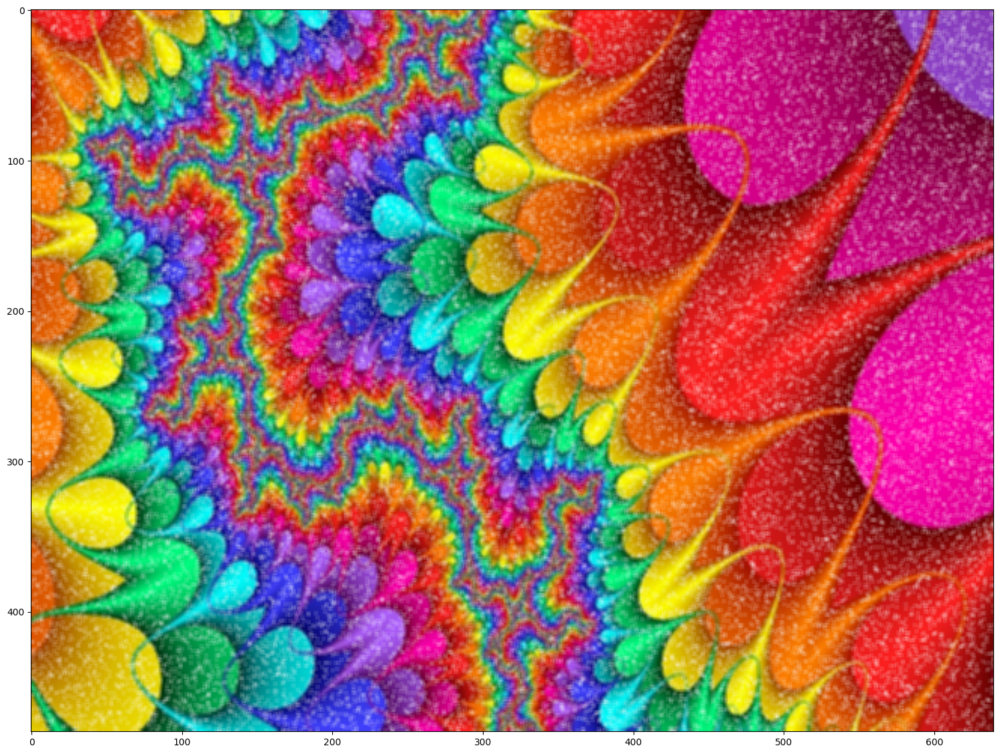

In [581]:
# Gaussian blur denoising
plt.figure(figsize=(20, 14))
show_rgb(blur(test))

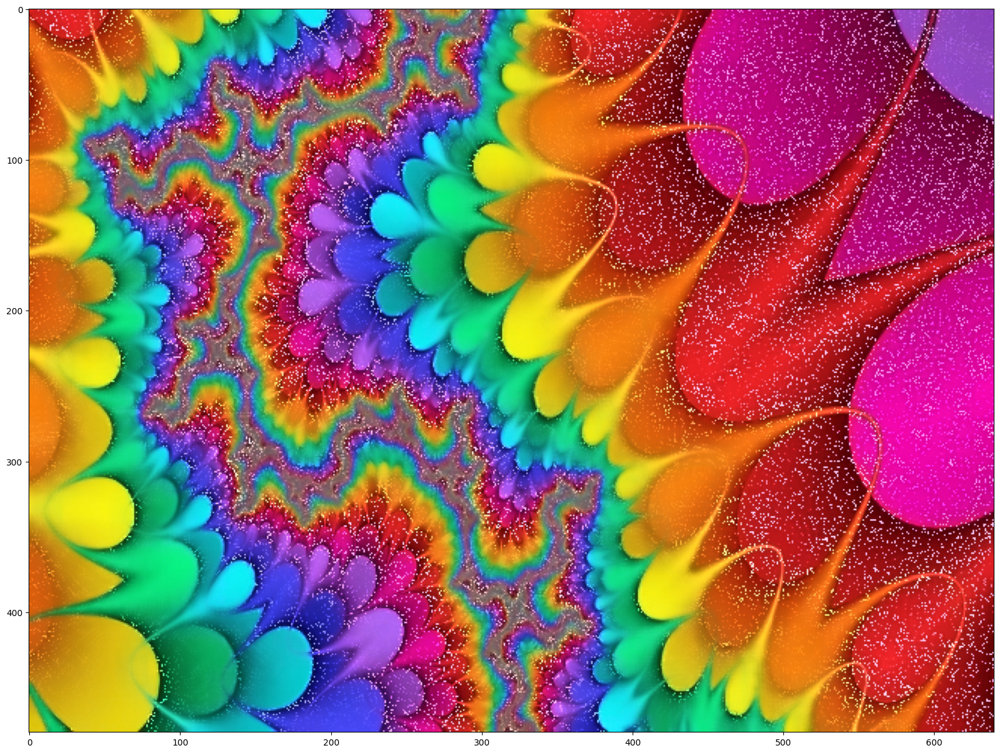

In [582]:
# Fill noise with 
z = cv2.fastNlMeansDenoisingColored(test,None,20,20,7,21) 
plt.figure(figsize=(20, 20))
show_rgb(z)

In [584]:
test_2 = resize(test, (120, 80))

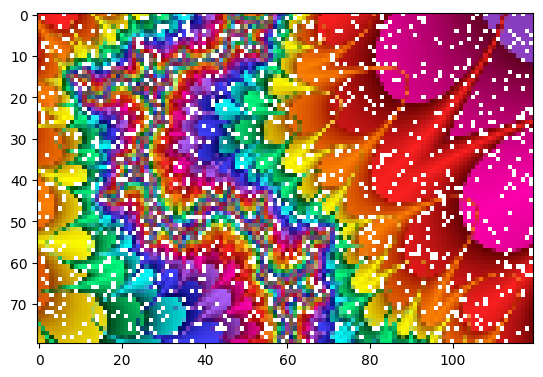

In [585]:
show_rgb(test_2)

#### Test fuzzy algo

In [636]:
plt.figure(figsize=(20, 20))
### Read image
img = read_rgb('t2.png')
img = resize(img, size=(120, 80))

### Introduce noise
noise = np.random.random(size=(img.shape[0], img.shape[1]))
# 10% noise
thresh = 0.5
mask = noise < thresh
test = img.copy()
test[mask, :] = (0, 0, 0)

<Figure size 2000x2000 with 0 Axes>

In [652]:
# fuzzy-algo
def max_conorm(a, b):
    return max(a, b)

conorm_fn = prod 

def fuzzy_denoise(image, conorm_fn):
    output = image.copy()
    for y in range(image.shape[0]):
        for x in range(image.shape[1]):
            r, g, b = image[y][x]
            neighbours = []
            if 0 <= y+1 < image.shape[0]:
                n = image[y+1][x]
                neighbours.append(n)

            if 0 <= y-1 < image.shape[0]:
                n = image[y-1][x]
                neighbours.append(n)

            if 0 <= x+1 < image.shape[1]:
                n = image[y][x+1]
                neighbours.append(n)

            if 0 <= x-1 < image.shape[1]:
                n = image[y][x-1]
                neighbours.append(n)

            neighbours_fuzzy = [FuzzyColor(n, conorm_fn=conorm) for n in neighbours]
            if len(neighbours_fuzzy) > 0:
                result = neighbours_fuzzy[0]
                for i in range(1, len(neighbours_fuzzy)):
                    result += neighbours_fuzzy[i]

                averaged = result.power(len(neighbours_fuzzy))
                r_avg, g_avg, b_avg = averaged.get_rgb()
                output[y][x] = (r_avg, g_avg, b_avg)
                  
    return output

output = fuzzy_denoise(test, conorm_fn)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [08:35<00:00, 57.31s/it]


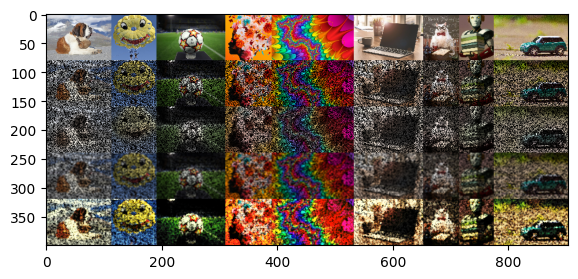

In [653]:
conorm_fn = prod

tests = [x for x in os.listdir('.') if x.endswith('.jpg') or x.endswith('.png')]
vstacks = []
for t in tqdm(tests):
    # Read and resize image
    img = read_rgb(t)
    size_h = 80
    coeff = img.shape[1]/img.shape[0]
    size_w = int(size_h * coeff)
    img = resize(img, size=(size_w, size_h))
    
    # Introduce noise
    noise = np.random.random(size=(img.shape[0], img.shape[1]))
    thresh = 0.5
    mask = noise < thresh
    noisy = img.copy()
    noisy[mask, :] = (0, 0, 0)

    # Denoise openCV 
    denoised_nlmeans = cv2.fastNlMeansDenoisingColored(noisy,None,20,20,7,21) 

    # Denoise gaussian (blur)
    denoised_blur = blur(noisy)

    # Denoised with fuzzy logic
    denoised_fuzzy = fuzzy_denoise(noisy, conorm_fn=conorm_fn)
    vstack = np.vstack([img, noisy, denoised_nlmeans, denoised_blur, denoised_fuzzy])
    vstacks.append(vstack)

grid = np.hstack(vstacks)
show_rgb(grid, figsize=(30, 30))

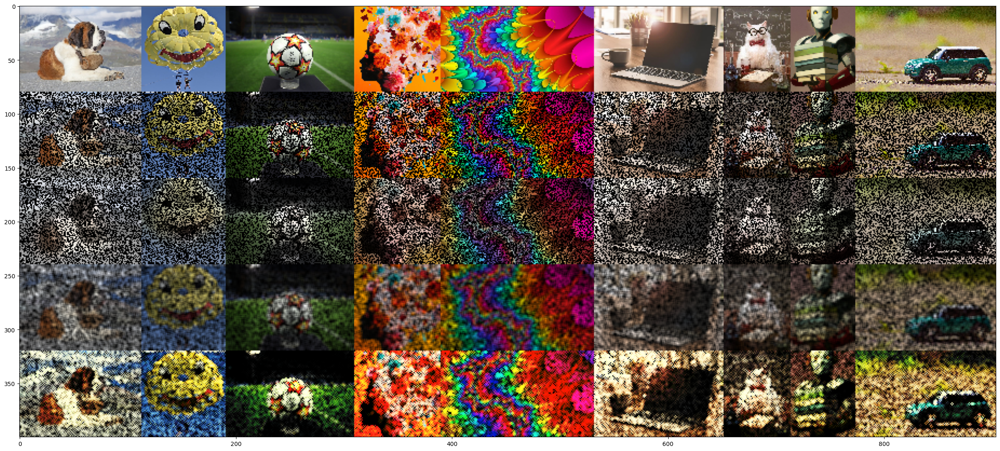

In [658]:
grid = np.hstack(vstacks)
show_rgb(grid, figsize=(30, 30))

In [617]:
# # Gaussian stuff
# import scipy.stats
# from scipy.stats import norm

# def gauss(x, color_intensity):
#     m = 0.5
#     epsilon = 1e-1
#     sigma = (1 - (color_intensity-epsilon)/255)**3
    
#     a = np.e**(-1*(((x-m)**2)/(2*(sigma**2))))
#     b = sigma * np.sqrt(2*np.pi)
#     pdf_y = a/b
    
#     ts = []
#     for i in np.arange(0.0, 1.01, 0.01):
#         ts.append(gauss_2(i, sigma, color_intensity))
#     m = np.array(ts).sum()

#     pmf_y = pdf_y/m
#     return pmf_y

# def gauss_2(x, sigma, color_intensity):
#     epsilon=1e-1
#     return norm.pdf(x, 0.5, sigma)

# from tqdm import tqdm
# %%time
# # Gauss-mine
# ts = []
# xs = np.arange(0.0, 1.01, 0.01)
# for i in xs:
#     t = gauss(i, 230)
#     ts.append(t)
# plt.plot(xs, ts)

# maxes = []
# intensities = range(0, 256)
# for intensity in tqdm(range(0, 256)):
#     ts = []
#     xs = np.arange(0.0, 1.01, 0.01)
#     for i in xs:
#         t = gauss(i, intensity)
#         ts.append(t)
#     maxes.append(max(ts))

# plt.plot(intensities, maxes)

# # r1 = FuzzyColor((255, 0, 0), tri)
# r2 = FuzzyColor((200, 200, 200), gauss)
# show(r2)